<a href="https://colab.research.google.com/github/Sandeepthirumurthi/CoLab/blob/main/GRIP_TASK_4.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **THE SPARK FOUNDATION**

## **Grip Task 2 : Exploratory Data Analysis - Terrorism (Jan21)**

### **Author : Sandeep Thirumurthi**

### ***Perform ‘Exploratory Data Analysis’ on dataset ‘Global Terrorism’***

#### ***1. As a security/defense analyst, try to find out the hot zone of terrorism.***

#### ***2. What all security issues and insights you can derive by EDA?***

#### *Dataset : https://drive.google.com/file/d/1luTU7xBvI7QAGPbQMxEHcgKUi9d6UeP_/view?usp=sharing*



### **Data Gathering**

In [ ]:
import pandas as pd 
import numpy as np 
import matplotlib.pyplot as plt 
import seaborn as sns

In [ ]:
data = pd.read_csv("E:\Downloads\Global Terrorism - START data\globalterrorismdb_0718dist.csv",encoding='ISO-8859-1')

print('Data Imported Successfully')

Data Imported Successfully


In [ ]:
data.head()

,eventid,iyear,imonth,iday,approxdate,extended,resolution,country,country_txt,region,...,addnotes,scite1,scite2,scite3,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
0,197000000001,1970,7,2,NaN,0,NaN,58,Dominican Republic,2,...,NaN,NaN,NaN,NaN,PGIS,0,0,0,0,NaN
1,197000000002,1970,0,0,NaN,0,NaN,130,Mexico,1,...,NaN,NaN,NaN,NaN,PGIS,0,1,1,1,NaN
2,197001000001,1970,1,0,NaN,0,NaN,160,Philippines,5,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
3,197001000002,1970,1,0,NaN,0,NaN,78,Greece,8,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
4,197001000003,1970,1,0,NaN,0,NaN,101,Japan,4,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN


In [ ]:
# Renaming columns for easy understanding

data.rename(columns={'iyear':'Year','imonth':'Month','extended':'Extended','iday':'Day','country_txt':'Country',
                   'provstate':'State','region_txt':'Region','attacktype1_txt':'AttackType','target1':'Target',
                   'nkill':'Killed','nwound':'Wounded','summary':'Summary','gname':'Group','targtype1_txt':'Target_type',
                   'weaptype1_txt':'Weapon_type','motive':'Motive','city':'City','latitude':'Latitude','longitude':'Longitude'},inplace=True)

data.head()

,eventid,Year,Month,Day,approxdate,Extended,resolution,country,Country,region,...,addnotes,scite1,scite2,scite3,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
0,197000000001,1970,7,2,NaN,0,NaN,58,Dominican Republic,2,...,NaN,NaN,NaN,NaN,PGIS,0,0,0,0,NaN
1,197000000002,1970,0,0,NaN,0,NaN,130,Mexico,1,...,NaN,NaN,NaN,NaN,PGIS,0,1,1,1,NaN
2,197001000001,1970,1,0,NaN,0,NaN,160,Philippines,5,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
3,197001000002,1970,1,0,NaN,0,NaN,78,Greece,8,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
4,197001000003,1970,1,0,NaN,0,NaN,101,Japan,4,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN


In [ ]:
# Choosing only necessary Columns 

data= data[['Year','Month','Extended','Day','Country','State','Region','City','Latitude','Longitude',
                 'AttackType','Killed','Wounded','Target','Group','Target_type','Weapon_type','Motive']]

data.head()

,Year,Month,Extended,Day,Country,State,Region,City,Latitude,Longitude,AttackType,Killed,Wounded,Target,Group,Target_type,Weapon_type,Motive
0,1970,7,0,2,Dominican Republic,NaN,Central America & Caribbean,Santo Domingo,18.456792,-69.951164,Assassination,1.0,0.0,Julio Guzman,MANO-D,Private Citizens & Property,Unknown,NaN
1,1970,0,0,0,Mexico,Federal,North America,Mexico city,19.371887,-99.086624,Hostage Taking (Kidnapping),0.0,0.0,"Nadine Chaval, daughter",23rd of September Communist League,Government (Diplomatic),Unknown,NaN
2,1970,1,0,0,Philippines,Tarlac,Southeast Asia,Unknown,15.478598,120.599741,Assassination,1.0,0.0,Employee,Unknown,Journalists & Media,Unknown,NaN
3,1970,1,0,0,Greece,Attica,Western Europe,Athens,37.997490,23.762728,Bombing/Explosion,NaN,NaN,U.S. Embassy,Unknown,Government (Diplomatic),Explosives,NaN
4,1970,1,0,0,Japan,Fukouka,East Asia,Fukouka,33.580412,130.396361,Facility/Infrastructure Attack,NaN,NaN,U.S. Consulate,Unknown,Government (Diplomatic),Incendiary,NaN


In [ ]:
# Total no.of Rows&Columns

data.shape

(181691, 18)

In [ ]:
# Checking for any null values

data.isnull().sum()

# .sum() used to know the values in numerical.If .sum() is not used the data shows in a table 

Year                0
Month               0
Extended            0
Day                 0
Country             0
State             421
Region              0
City              434
Latitude         4556
Longitude        4557
AttackType          0
Killed          10313
Wounded         16311
Target            636
Group               0
Target_type         0
Weapon_type         0
Motive         131130
dtype: int64

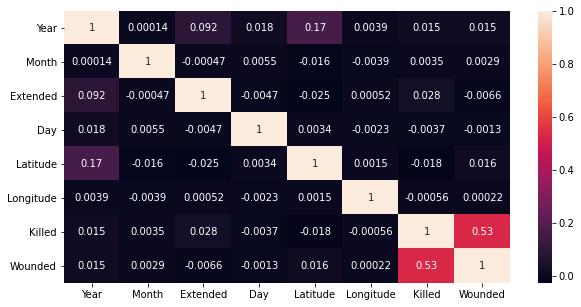

In [ ]:
# finding the pairwise correlations between the columns and visualising using heatmaps

plt.figure(figsize=(10,5))
sns.heatmap(data.corr(), annot=True)

plt.show()

### **Top 10 Countries with most Terrorist Attacks.**

In [ ]:
print("Country with the most attacks:\n",data['Country'].value_counts().head(10))

Country with the most attacks:
 Iraq              24636
Pakistan          14368
Afghanistan       12731
India             11960
Colombia           8306
Philippines        6908
Peru               6096
El Salvador        5320
United Kingdom     5235
Turkey             4292
Name: Country, dtype: int64


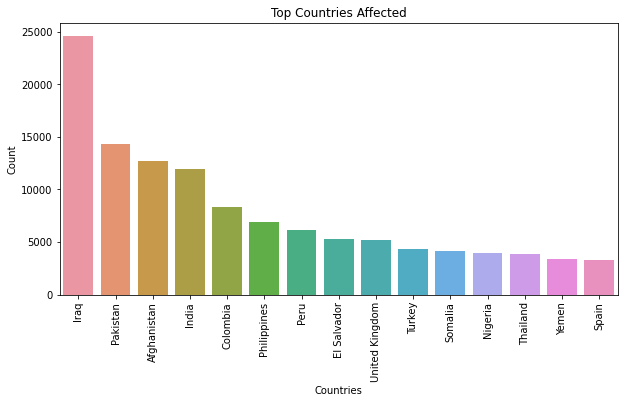

In [ ]:
plt.figure(figsize = (10,5))
sns.barplot(data['Country'].value_counts()[:15].index,data['Country'].value_counts()[:15].values)
plt.title('Top Countries Affected')
plt.xlabel('Countries')
plt.ylabel('Count')
plt.xticks(rotation= 90)

plt.show()

Therefore, the country with most attacks is Iraq

### **States with most Terrorist Attack**

In [ ]:
print('State with the most attacks:\n',data['State'].value_counts())

State with the most attacks:
 Baghdad               7645
Northern Ireland      4498
Unknown               4290
Balochistan           3710
Saladin               3411
                      ... 
Saone-et-Loire           1
Dakhlet Nouadhibou       1
Seine-et-Marne           1
Lakhdaria Province       1
Jabal al Akhdar          1
Name: State, Length: 2855, dtype: int64


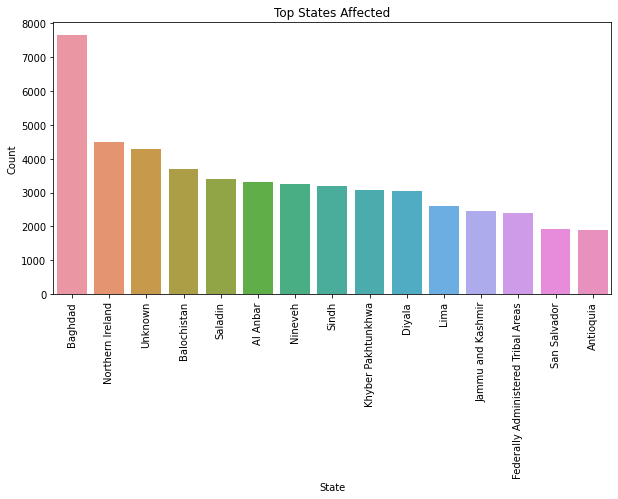

In [ ]:
plt.figure(figsize = (10,5))
sns.barplot(data['State'].value_counts()[:15].index,data['State'].value_counts()[:15].values)
plt.title('Top States Affected')
plt.xlabel('State')
plt.ylabel('Count')
plt.xticks(rotation= 90)

plt.show()

Most affected state is Baghdad

### **Regions with most Terrorist Attacks**

In [ ]:
print("Region with the most attacks: \n",data['Region'].value_counts())

Region with the most attacks: 
 Middle East & North Africa     50474
South Asia                     44974
South America                  18978
Sub-Saharan Africa             17550
Western Europe                 16639
Southeast Asia                 12485
Central America & Caribbean    10344
Eastern Europe                  5144
North America                   3456
East Asia                        802
Central Asia                     563
Australasia & Oceania            282
Name: Region, dtype: int64


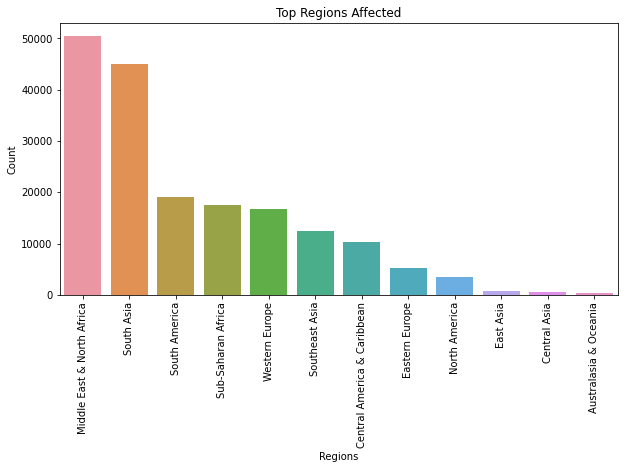

In [ ]:
plt.figure(figsize = (10,5))
sns.barplot(data['Region'].value_counts()[:15].index,data['Region'].value_counts()[:15].values)
plt.title('Top Regions Affected')
plt.xlabel('Regions')
plt.ylabel('Count')
plt.xticks(rotation = 90)

plt.show()

Therefore, the most affected region is Middle East & North Africa.

### **Cities with most Terrorist Attacks**

In [ ]:
print("Cities with the most attacks: \n",data['City'].value_counts())

Cities with the most attacks: 
 Unknown    9775
Baghdad    7589
Karachi    2652
Lima       2359
Mosul      2265
           ... 
Bagana        1
Opogodo       1
Qaraj         1
Condoto       1
Umaria        1
Name: City, Length: 36674, dtype: int64


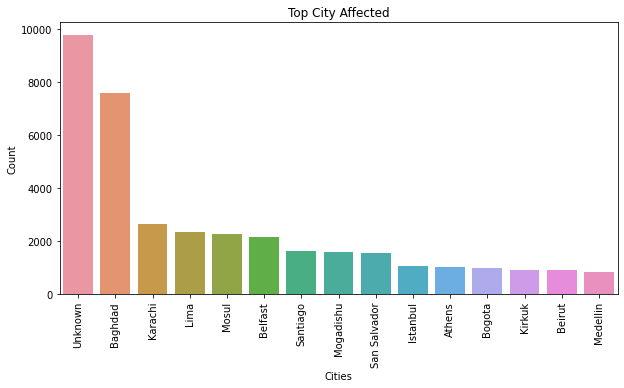

In [ ]:
plt.figure(figsize = (10,5))
sns.barplot(data['City'].value_counts()[:15].index,data['City'].value_counts()[:15].values)
plt.title('Top City Affected')
plt.xlabel('Cities')
plt.ylabel('Count')
plt.xticks(rotation = 90)

plt.show()

City with most attacks is baghdad since the first is unknown

### **Years with most Terrorist Activity**

In [ ]:
print("Year with the most attacks:\n",data['Year'].value_counts().head(10))

Year with the most attacks:
 2014    16903
2015    14965
2016    13587
2013    12036
2017    10900
2012     8522
2011     5076
1992     5071
2010     4826
2008     4805
Name: Year, dtype: int64


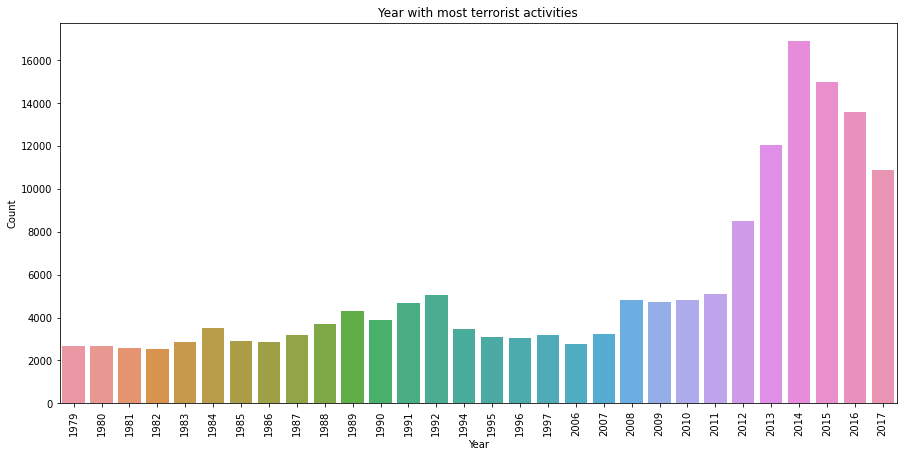

In [ ]:
plt.figure(figsize = (15,7))
sns.barplot(data['Year'].value_counts()[:30].index,data['Year'].value_counts()[:30].values)
plt.title('Year with most terrorist activities')
plt.xlabel('Year')
plt.ylabel('Count')
plt.xticks(rotation = 90)

plt.show()

Year with most attack is 2014

### **Most Frequent Attack Type**

In [ ]:
print("Most Frequent Attack Types:\n",data['AttackType'].value_counts())

Most Frequent Attack Types:
 Bombing/Explosion                      88255
Armed Assault                          42669
Assassination                          19312
Hostage Taking (Kidnapping)            11158
Facility/Infrastructure Attack         10356
Unknown                                 7276
Unarmed Assault                         1015
Hostage Taking (Barricade Incident)      991
Hijacking                                659
Name: AttackType, dtype: int64


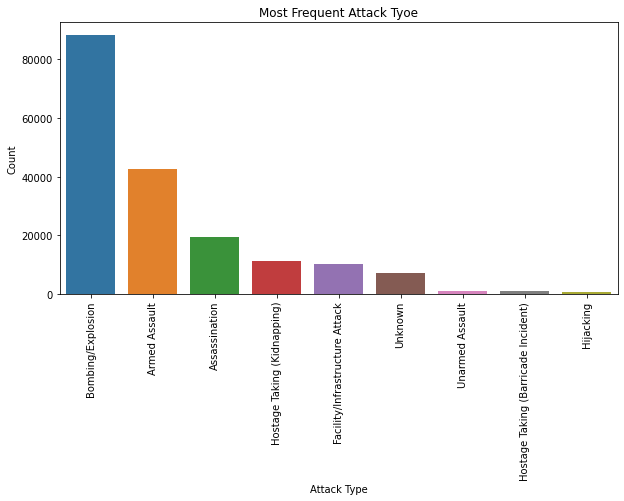

In [ ]:
plt.figure(figsize = (10,5))
sns.barplot(data['AttackType'].value_counts()[:15].index,data['AttackType'].value_counts()[:15].values)
plt.title('Most Frequent Attack Tyoe')
plt.xlabel('Attack Type')
plt.ylabel('Count')
plt.xticks(rotation = 90)

plt.show()

Most frequent Attack Type is Bombing / Explosion

### **Most Frequent Groups invovled in past terrorist activity**

In [ ]:
print("Group with the most attacks:\n",data['Group'].value_counts().head())

Group with the most attacks:
 Unknown                                             82782
Taliban                                              7478
Islamic State of Iraq and the Levant (ISIL)          5613
Shining Path (SL)                                    4555
Farabundo Marti National Liberation Front (FMLN)     3351
Name: Group, dtype: int64


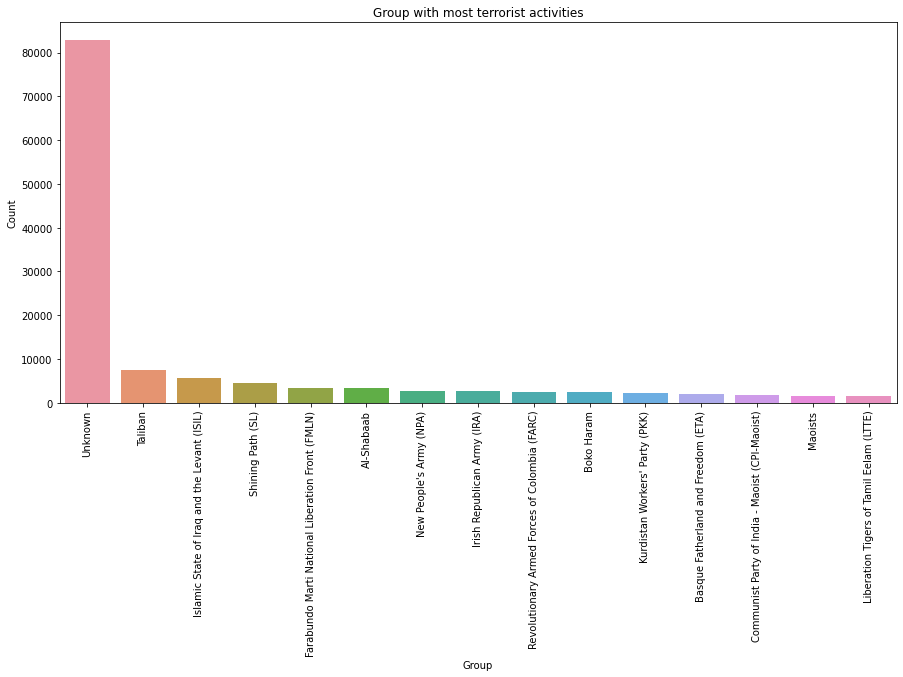

In [ ]:
plt.figure(figsize = (15,7))
sns.barplot(data['Group'].value_counts()[:15].index,data['Group'].value_counts()[:15].values)
plt.title('Group with most terrorist activities')
plt.xlabel('Group')
plt.ylabel('Count')
plt.xticks(rotation = 90)

plt.show()

### **The most frequent group in past terror attacks is taliban since the first is unknown**

In [ ]:
print("Most popular Weapon Type :\n",data['Weapon_type'].value_counts().head(10))

Most popular Weapon Type :
 Explosives                                                                     92426
Firearms                                                                       58524
Unknown                                                                        15157
Incendiary                                                                     11135
Melee                                                                           3655
Chemical                                                                         321
Sabotage Equipment                                                               141
Vehicle (not to include vehicle-borne explosives, i.e., car or truck bombs)      136
Other                                                                            114
Biological                                                                        35
Name: Weapon_type, dtype: int64


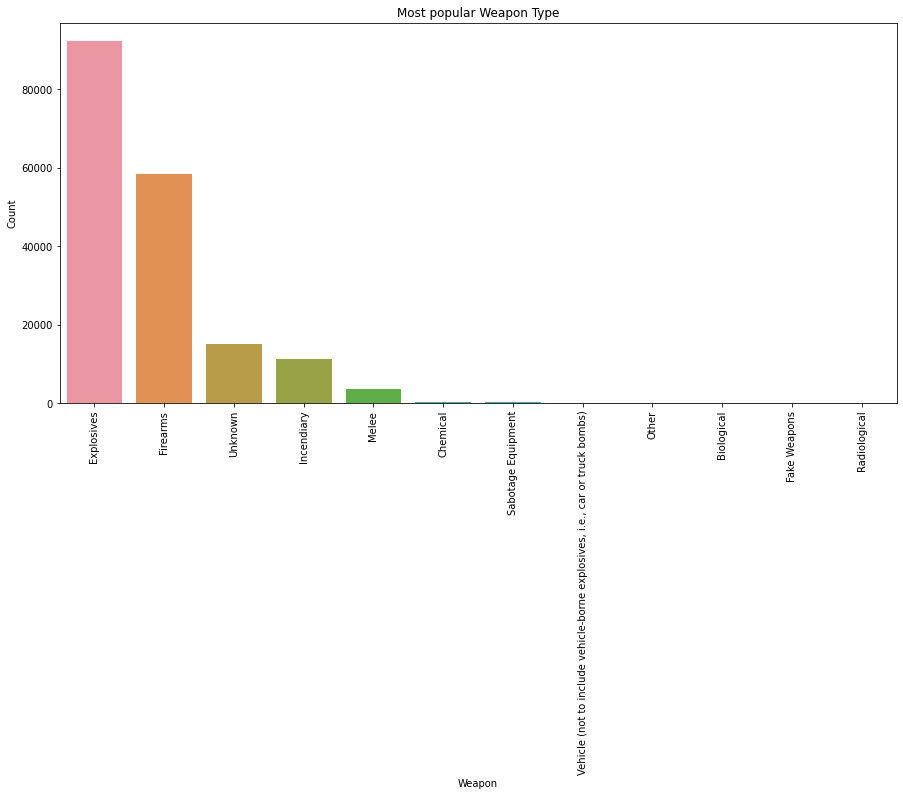

In [ ]:
plt.figure(figsize = (15,7))
sns.barplot(data['Weapon_type'].value_counts()[:15].index,data['Weapon_type'].value_counts()[:15].values)
plt.title('Most popular Weapon Type')
plt.xlabel('Weapon')
plt.ylabel('Count')
plt.xticks(rotation = 90)

plt.show()

Most popular weapon type is explosives.

### **Killed vs Wounded Visualization**

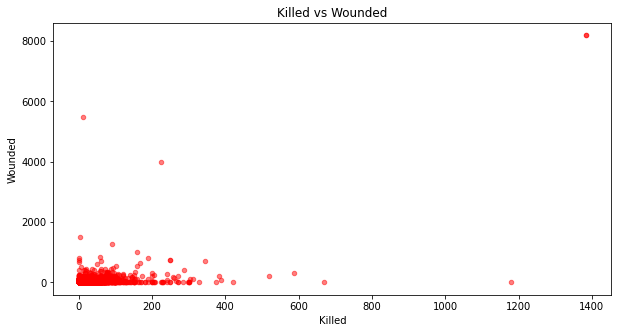

In [ ]:
data.plot(kind = 'scatter', x = 'Killed', y = 'Wounded', alpha = 0.5, color = 'red', figsize = (10,5))
plt.xlabel('Killed')
plt.ylabel('Wounded')
plt.title('Killed vs Wounded')

plt.show()


## **Conclusion:**
###  Hot zones
1. Most affected countries are Iraq, Pakistan and Afganistan.
2. Most affected state is Baghdad
3. Most affected region is Middle East and North Africa
4. Most affected year in the past is 2014
###Insights drawn
1. The most frequent attack type is Bombing/Explosion so people need to practice a little alertness in crowded places.
2. The most popular weapon is explosives.